<div >
<img src = "figs/ans_banner_1920x200.png" />
</div>

# Proyecto Final - Grupo_24

En este proyecto se realizara la creacion de segmentos para los usuarios de tarjetas de credito para los clientes bancarios de BOCC los cuales presentan un uso de TC.

Se realizara el proceso de cargue de informacion, limpieza de datos, analisis de los datos e implementacion de los modelos de clustering.

## Importar librerias

In [1]:
# Librerias base para manejo de registros
import pandas as pd
pd.set_option('display.float_format', '{:.6f}'.format)
pd.set_option('display.max_columns', None)
import numpy as np

# estandarizacion de datos
from sklearn.preprocessing import StandardScaler

# Modelos de clustering
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN

# Metodos para calibrar hiperparametros
from sklearn.neighbors import NearestNeighbors
from kneed import KneeLocator

# Libnreria para medir los resultados de los modelos
from sklearn.metrics import silhouette_score, adjusted_rand_score, normalized_mutual_info_score


# Libreria para graficar
import matplotlib.pyplot as plt
import seaborn as sns

# Reduccion de dimensiones
from sklearn.decomposition import PCA

# matrix de distancia
import gower


## Cargar bases de datos

In [2]:
# Cargue de los datos
df_info_clientes_banco = pd.read_csv("data/infoclientebanca.csv")
df_info_clientes_banco.head()

,CLIENTE,grupo_de_cliente,Numero_de_transacciones,promedio_por_transaccion,transaccion_minima,transaccion_maxima,porcentaje_visa_nacional,porcentaje_visa_internacional,porcentaje_mastercard_nacional,porcentaje_mastercard_internacional,Porcentaje_otrafranquicia_nacional,porcentaje_otrafranquicia_internacional,porcentaje_nacional_total,porcentaje_internacional_total,porcentaje_manana,porcentaje_tarde,porcentaje_noche,porcDOMINGO,porcLUNES,porcMARTES,porcMIERCOLES,porcJUEVES,porcVIERNES,porcSABADO,Sitio_consumo_masfrecuente,Compras_Totales
0,1,A,1,459930.300000,459930.300000,459930.300000,0.00%,100.00%,0.00%,0.00%,0.00%,0.00%,0.00%,100.00%,0.00%,0.00%,100.00%,0.00%,0.00%,100.00%,0.00%,0.00%,0.00%,0.00%,CLINICAS - HOSPITALES,459.930
1,2,A,3,582666.700000,350000.000000,699000.000000,100.00%,0.00%,0.00%,0.00%,0.00%,0.00%,100.00%,0.00%,0.00%,100.00%,0.00%,0.00%,66.67%,0.00%,0.00%,33.33%,0.00%,0.00%,MERCADEO DIRECTO - COMERCIANTES DE VENTAS TELE...,1.748.000
2,3,A,3,616547.000000,616547.000000,616547.000000,100.00%,0.00%,0.00%,0.00%,0.00%,0.00%,100.00%,0.00%,100.00%,0.00%,0.00%,0.00%,0.00%,0.00%,100.00%,0.00%,0.00%,0.00%,DROGUERIAS. FARMACIAS. TIENDAS NATURISTAS,1.849.641
3,4,A,10,144467.100000,20000.000000,328444.000000,0.00%,0.00%,100.00%,0.00%,0.00%,0.00%,100.00%,0.00%,40.00%,60.00%,0.00%,0.00%,60.00%,20.00%,0.00%,10.00%,0.00%,10.00%,ALMACEN POR DEPARTAMENTO CON SUPERMERCADO,1.444.671
4,5,A,1,321764.000000,321764.000000,321764.000000,100.00%,0.00%,0.00%,0.00%,0.00%,0.00%,100.00%,0.00%,0.00%,100.00%,0.00%,100.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,ALMACEN POR DEPARTAMENTO CON SUPERMERCADO,321.764


## Limpieza de datos

In [3]:
# validacion de campos con valores nulos
df_info_clientes_banco.isnull().sum()

CLIENTE                                    0
grupo_de_cliente                           0
Numero_de_transacciones                    0
promedio_por_transaccion                   0
transaccion_minima                         0
transaccion_maxima                         0
porcentaje_visa_nacional                   0
porcentaje_visa_internacional              0
porcentaje_mastercard_nacional             0
porcentaje_mastercard_internacional        0
Porcentaje_otrafranquicia_nacional         0
porcentaje_otrafranquicia_internacional    0
porcentaje_nacional_total                  0
porcentaje_internacional_total             0
porcentaje_manana                          0
porcentaje_tarde                           0
porcentaje_noche                           0
porcDOMINGO                                0
porcLUNES                                  0
porcMARTES                                 0
porcMIERCOLES                              0
porcJUEVES                                 0
porcVIERNE

In [4]:
# validacion de tipos de datos
df_info_clientes_banco.dtypes

CLIENTE                                      int64
grupo_de_cliente                            object
Numero_de_transacciones                      int64
promedio_por_transaccion                   float64
transaccion_minima                         float64
transaccion_maxima                         float64
porcentaje_visa_nacional                    object
porcentaje_visa_internacional               object
porcentaje_mastercard_nacional              object
porcentaje_mastercard_internacional         object
Porcentaje_otrafranquicia_nacional          object
porcentaje_otrafranquicia_internacional     object
porcentaje_nacional_total                   object
porcentaje_internacional_total              object
porcentaje_manana                           object
porcentaje_tarde                            object
porcentaje_noche                            object
porcDOMINGO                                 object
porcLUNES                                   object
porcMARTES                     

In [5]:
# quitar los puntos de el valor de compras totales
df_info_clientes_banco["Compras_Totales"] = df_info_clientes_banco["Compras_Totales"].str.replace('.', '', regex=False)
# quitar espacios de el valor de compras totales
df_info_clientes_banco["Compras_Totales"] = df_info_clientes_banco["Compras_Totales"].str.strip()  # Elimina espacios
# transformar el campo de string a numeric
df_info_clientes_banco["Compras_Totales"] = pd.to_numeric(df_info_clientes_banco["Compras_Totales"], errors='coerce')

# seleccionar los campos con valores de datos en porcentajes
campos_porcentaje = ["porcentaje_visa_nacional", "porcentaje_visa_internacional", "porcentaje_mastercard_nacional", "porcentaje_mastercard_internacional", "Porcentaje_otrafranquicia_nacional", "porcentaje_otrafranquicia_internacional", "porcentaje_nacional_total", "porcentaje_internacional_total", "porcentaje_manana", "porcentaje_tarde", "porcentaje_noche", "porcDOMINGO", "porcLUNES", "porcMARTES", "porcMIERCOLES", "porcJUEVES", "porcVIERNES", "porcSABADO"]
# transformar los campos de string de porcentajes a valores numericos
for campo in campos_porcentaje:
    df_info_clientes_banco[campo] = df_info_clientes_banco[campo].str.replace('%', '', regex=False)  # Eliminar el símbolo '%'
    df_info_clientes_banco[campo] = pd.to_numeric(df_info_clientes_banco[campo], errors='coerce') # Convertir a número y dividir por 100

# realizar transformacion de dummys para los campos string
df_info_clientes_banco["Sitio_consumo_masfrecuente_dummy"] = pd.factorize(df_info_clientes_banco['Sitio_consumo_masfrecuente'])[0]
df_info_clientes_banco["grupo_de_cliente_dummy"] = pd.factorize(df_info_clientes_banco['grupo_de_cliente'])[0]
# mostrar el data frame ajustado
df_info_clientes_banco.head()

,CLIENTE,grupo_de_cliente,Numero_de_transacciones,promedio_por_transaccion,transaccion_minima,transaccion_maxima,porcentaje_visa_nacional,porcentaje_visa_internacional,porcentaje_mastercard_nacional,porcentaje_mastercard_internacional,Porcentaje_otrafranquicia_nacional,porcentaje_otrafranquicia_internacional,porcentaje_nacional_total,porcentaje_internacional_total,porcentaje_manana,porcentaje_tarde,porcentaje_noche,porcDOMINGO,porcLUNES,porcMARTES,porcMIERCOLES,porcJUEVES,porcVIERNES,porcSABADO,Sitio_consumo_masfrecuente,Compras_Totales,Sitio_consumo_masfrecuente_dummy,grupo_de_cliente_dummy
0,1,A,1,459930.300000,459930.300000,459930.300000,0.000000,100.000000,0.000000,0.000000,0.000000,0.000000,0.000000,100.000000,0.000000,0.000000,100.000000,0.000000,0.000000,100.000000,0.000000,0.000000,0.000000,0.000000,CLINICAS - HOSPITALES,459930,0,0
1,2,A,3,582666.700000,350000.000000,699000.000000,100.000000,0.000000,0.000000,0.000000,0.000000,0.000000,100.000000,0.000000,0.000000,100.000000,0.000000,0.000000,66.670000,0.000000,0.000000,33.330000,0.000000,0.000000,MERCADEO DIRECTO - COMERCIANTES DE VENTAS TELE...,1748000,1,0
2,3,A,3,616547.000000,616547.000000,616547.000000,100.000000,0.000000,0.000000,0.000000,0.000000,0.000000,100.000000,0.000000,100.000000,0.000000,0.000000,0.000000,0.000000,0.000000,100.000000,0.000000,0.000000,0.000000,DROGUERIAS. FARMACIAS. TIENDAS NATURISTAS,1849641,2,0
3,4,A,10,144467.100000,20000.000000,328444.000000,0.000000,0.000000,100.000000,0.000000,0.000000,0.000000,100.000000,0.000000,40.000000,60.000000,0.000000,0.000000,60.000000,20.000000,0.000000,10.000000,0.000000,10.000000,ALMACEN POR DEPARTAMENTO CON SUPERMERCADO,1444671,3,0
4,5,A,1,321764.000000,321764.000000,321764.000000,100.000000,0.000000,0.000000,0.000000,0.000000,0.000000,100.000000,0.000000,0.000000,100.000000,0.000000,100.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,ALMACEN POR DEPARTAMENTO CON SUPERMERCADO,321764,3,0


## Analisis data

In [6]:
# dimensiones del data frame
df_info_clientes_banco.shape

(47871, 28)

In [7]:
# estadisticos descriptivos del data frame
df_info_clientes_banco.describe()

,CLIENTE,Numero_de_transacciones,promedio_por_transaccion,transaccion_minima,transaccion_maxima,porcentaje_visa_nacional,porcentaje_visa_internacional,porcentaje_mastercard_nacional,porcentaje_mastercard_internacional,Porcentaje_otrafranquicia_nacional,porcentaje_otrafranquicia_internacional,porcentaje_nacional_total,porcentaje_internacional_total,porcentaje_manana,porcentaje_tarde,porcentaje_noche,porcDOMINGO,porcLUNES,porcMARTES,porcMIERCOLES,porcJUEVES,porcVIERNES,porcSABADO,Compras_Totales,Sitio_consumo_masfrecuente_dummy,grupo_de_cliente_dummy
count,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000,47871.000000
mean,23936.000000,5.083161,371602.687994,253089.817521,580731.855251,37.487507,3.645922,53.932185,2.654887,1.388450,0.891034,92.808155,7.191846,28.804884,58.374230,12.820821,13.932558,13.173200,13.274230,13.947279,13.622064,14.152377,17.898014,1422281.829709,16.153266,0.189280
std,13819.311705,8.483558,579821.741503,518155.912390,885419.138315,41.346952,16.041107,42.501955,13.522132,9.121183,8.031518,22.947329,22.947331,36.324008,39.319005,26.446157,28.016771,26.533006,26.583531,27.222813,26.860637,27.316936,30.778624,2914069.592060,15.830453,0.632554
min,1.000000,1.000000,1.000000,0.040000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000
25%,11968.500000,1.000000,81000.000000,30700.000000,114200.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,100.000000,0.000000,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,177575.000000,5.000000,0.000000
50%,23936.000000,2.000000,167173.750000,80000.000000,257933.000000,20.000000,0.000000,57.140000,0.000000,0.000000,0.000000,100.000000,0.000000,8.330000,63.640000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,494960.000000,7.000000,0.000000
75%,35903.500000,5.000000,383667.450000,217800.000000,627401.000000,82.760000,0.000000,100.000000,0.000000,0.000000,0.000000,100.000000,0.000000,50.000000,100.000000,11.760000,14.290000,14.290000,14.290000,16.670000,16.670000,16.670000,25.000000,1433755.500000,26.000000,0.000000
max,47871.000000,142.000000,6262025.000000,6148920.000000,11040000.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,66293406.000000,108.000000,4.000000


In [8]:
# validar los tipos de grupos y sus cantidades
df_info_clientes_banco.groupby("grupo_de_cliente").size().reset_index(name='cantidad')

,grupo_de_cliente,cantidad
0,A,42679
1,B,3014
2,C,1003
3,D,831
4,E,344


In [9]:
# validar la cantidad de sitios consumo frecuente
df_info_clientes_banco["Sitio_consumo_masfrecuente"].nunique()

109

In [10]:
# mostrar los 5 sitios consumo frecuente con mayor cantidad de usuarios 
df_info_clientes_banco.groupby("Sitio_consumo_masfrecuente").size().reset_index(name='cantidad').sort_values(by="cantidad", ascending=False).head()

,Sitio_consumo_masfrecuente,cantidad
96,SUPERMERCADOS / TIENDAS EXPRESS,9204
7,ALMACEN POR DEPARTAMENTO CON SUPERMERCADO,6207
12,ALMACENES DE CALZADO,4447
27,ALMACENES DE VESTUARIO Y ACCESORIOS PARA TODA ...,3379
95,SIN NOMBRE,3276


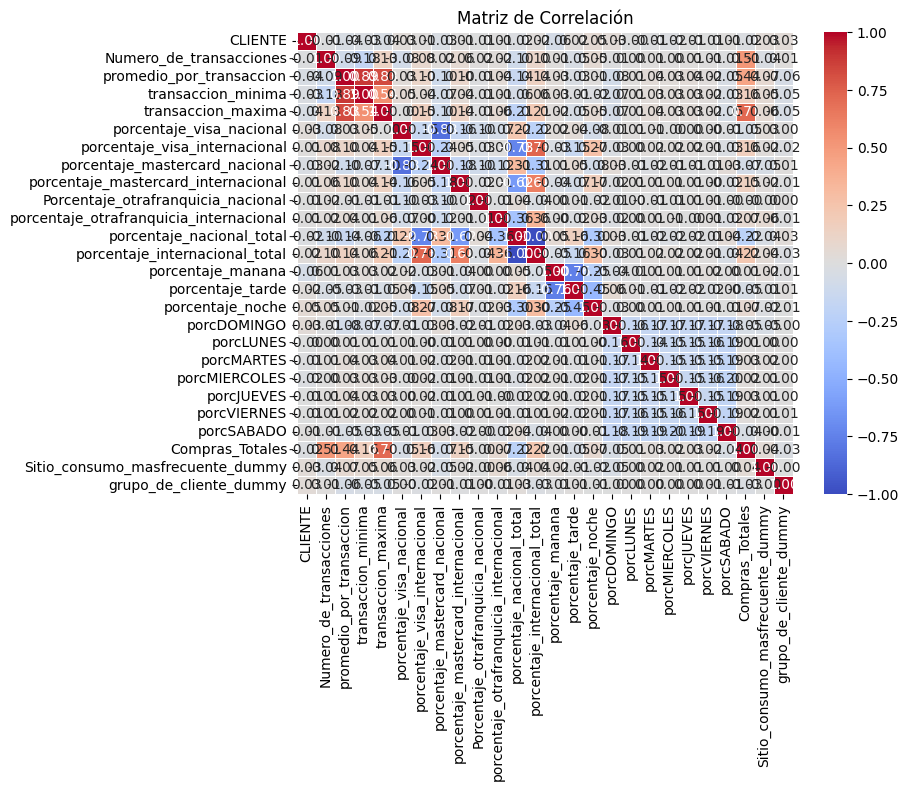

In [11]:
# Calcular la matriz de correlación
correlation_matrix = df_info_clientes_banco.drop(['Sitio_consumo_masfrecuente', 'grupo_de_cliente'], axis=1).corr()

# Crear una gráfica de la matriz de correlación usando un mapa de calor
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Matriz de Correlación')
plt.show()

## Implementacion modelos

In [12]:
# Quitar los campos String con valores originales
df_info_clientes_banco_X = df_info_clientes_banco.drop(['Sitio_consumo_masfrecuente', 'grupo_de_cliente'], axis=1)
# Quitar los campos con alta correlacion
df_info_clientes_banco_X = df_info_clientes_banco_X.drop(['transaccion_minima', 'transaccion_maxima', 'porcentaje_nacional_total', 'porcentaje_internacional_total'], axis=1)

# estandarizar los datos del data set
scaler = StandardScaler()
df_info_clientes_banco_scaled = scaler.fit_transform(df_info_clientes_banco_X)


### Cluster optimos

In [13]:
# Numero de cluster a validar
rg=10

# Inicializar estructuras necesarias para la seleccion de cluster optimo
varianza_intra_cluster = []
silhouettes = []

# iterar entre todos los posibles clusters seleccionados para encontrar el optimo
for k in range (1, rg): # Evaluamos entre 1 a rg clusters posibles
    kmeans = KMeans(n_clusters = k, random_state = 123, n_init=10).fit(df_info_clientes_banco_scaled)
    varianza_intra_cluster.append(kmeans.inertia_)
    try:
        silhouette = silhouette_score(df_info_clientes_banco_scaled, kmeans.labels_)
    except:
        silhouette = 0 # El índice de Silhouette sólo se puede calcular cuando se tiene K>1
    silhouettes.append(silhouette)

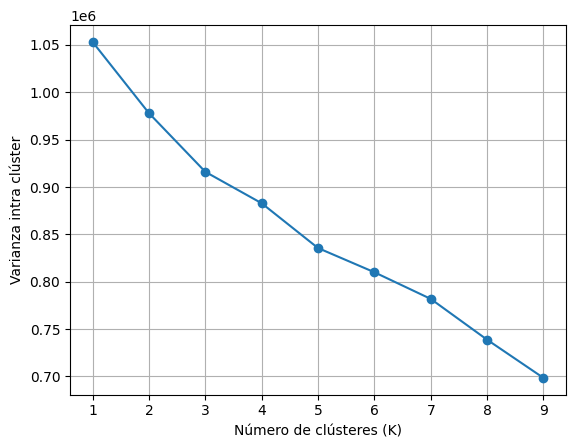

In [31]:
# Graficar la varianza intra cluster por cada uno de las posibles combinaciones de cluster a validar
plt.plot(range(1, rg), varianza_intra_cluster, marker='o')
plt.xlabel('Número de clústeres (K)')
plt.ylabel('Varianza intra clúster')
plt.grid()
plt.show()

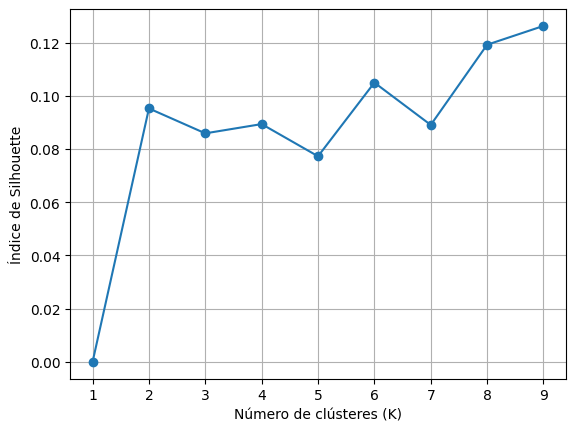

In [15]:
# Graficar el indice de sihoutette por cada uno de las posibles combinaciones de cluster a validar
plt.plot(range(1, rg), silhouettes, marker='o')
plt.xlabel('Número de clústeres (K)')
plt.ylabel('Índice de Silhouette')
plt.grid()
plt.show()

### Kmeas

In [33]:
# Implementar algoritmo de k medias sobre los datos estandarizados y la configuracion solicitada
kmeans_1 = KMeans(n_clusters = 3, random_state = 123, n_init=10).fit(df_info_clientes_banco_scaled)
df_info_clientes_banco["Cluster"] = kmeans_1.labels_

# describe sobre el df con los labels
df_info_clientes_banco.groupby('Cluster').describe()

CLIENTE                                                  \
               count         mean          std      min          25%   
Cluster                                                                
0       25167.000000 23364.023563 13740.762767 4.000000 11593.500000   
1       18201.000000 24584.999066 13926.830735 2.000000 12513.000000   
2        4503.000000 24509.506329 13683.513977 1.000000 11631.500000   

                                               Numero_de_transacciones  \
                 50%          75%          max                   count   
Cluster                                                                  
0       23076.000000 34958.500000 47871.000000            25167.000000   
1       24922.000000 36998.000000 47870.000000            18201.000000   
2       25694.000000 36719.500000 47869.000000             4503.000000   

                                                                             \
             mean       std      min      25%      50%       75%        max   
Cluster                                                                       
0        4.860889  6.620898 1.000000 1.000000 2.000000  6.000000  77.000000   
1        3.439756  4.222247 1.000000 1.000000 2.000000  4.000000  64.000000   
2       12.968021 19.359131 1.000000 2.000000 5.000000 14.000000 142.000000   

        promedio_por_transaccion                                          \
                           count          mean           std         min   
Cluster                                                                    
0                   25167.000000 303454.362620 478019.847688 1000.000000   
1                   18201.000000 378440.163189 594253.758003 1000.000000   
2                    4503.000000 724842.754324 847862.043454    1.000000   

                                                                  \
                  25%           50%           75%            max   
Cluster                                                            
0        76234.270000 148691.620000 307339.170000 5966212.000000   
1        79900.000000 169900.000000 391600.000000 6148920.000000   
2       166164.095000 399993.600000 944615.900000 6262025.000000   

        transaccion_minima                                                    \
                     count          mean           std      min          25%   
Cluster                                                                        
0             25167.000000 217141.440349 452302.891795 1.000000 30000.000000   
1             18201.000000 280484.565432 557115.937480 0.040000 38000.000000   
2              4503.000000 343274.361508 661887.955491 1.000000 19202.910000   

                                                  transaccion_maxima  \
                 50%           75%            max              count   
Cluster                                                                
0       71360.000000 195505.000000 5966212.000000       25167.000000   
1       94850.000000 248000.000000 6148920.000000       18201.000000   
2       77800.000000 318070.000000 5837440.000000        4503.000000   

                                                                               \
                  mean            std         min           25%           50%   
Cluster                                                                         
0        454071.209138  638149.921106 1000.000000 107000.000000 229980.000000   
1        526611.914518  771464.504037 1000.000000 104000.000000 240000.000000   
2       1507381.982283 1641074.566346    1.000000 364030.500000 950383.000000   

                                       porcentaje_visa_nacional            \
                   75%             max                    count      mean   
Cluster                                                                     
0        500000.000000  9600000.000000             25167.000000  7.143801   
1        581699.000000  8906464.000000             18201.000000 85.621457   
2       

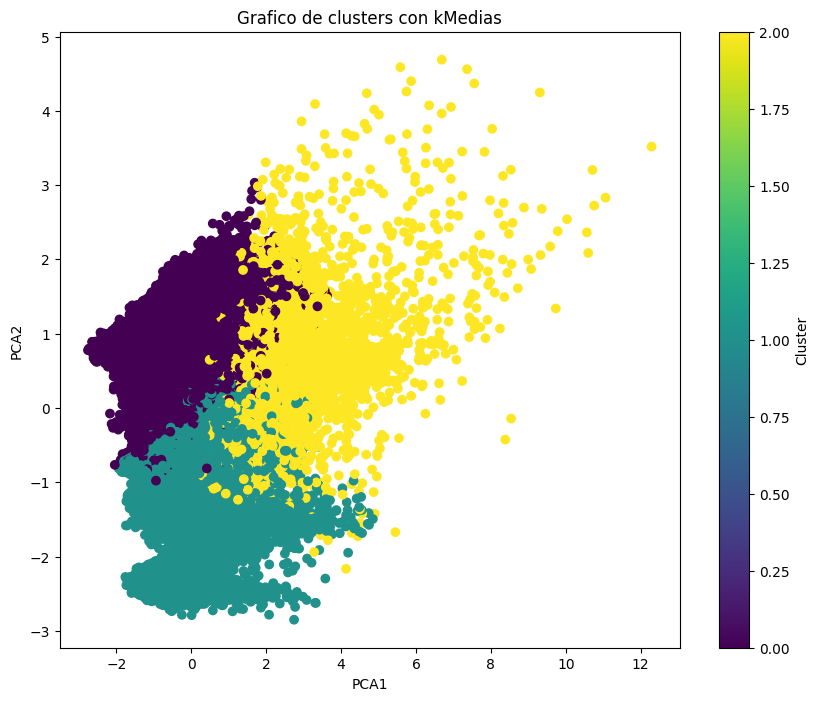

In [17]:
# Reducción de dimensionalidad con PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(df_info_clientes_banco_scaled)

# Crear un DataFrame con las coordenadas PCA y los clusters
df_pca = pd.DataFrame(X_pca, columns=['PCA1', 'PCA2'])
df_pca['Cluster'] = kmeans_1.labels_

# Graficar
plt.figure(figsize=(10, 8))
plt.scatter(df_pca['PCA1'], df_pca['PCA2'], c=df_pca['Cluster'], cmap='viridis', marker='o')
plt.colorbar(label='Cluster')
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.title('Grafico de clusters con kMedias')
plt.show()

In [18]:
# Validar metricas
print("varianza_intra_cluster: ", kmeans_1.inertia_)
print("silhouette: ", silhouette_score(df_info_clientes_banco_scaled, kmeans_1.labels_))

varianza_intra_cluster:  916037.6687144643
silhouette:  0.08589442457980744


### PCA - Kmeans

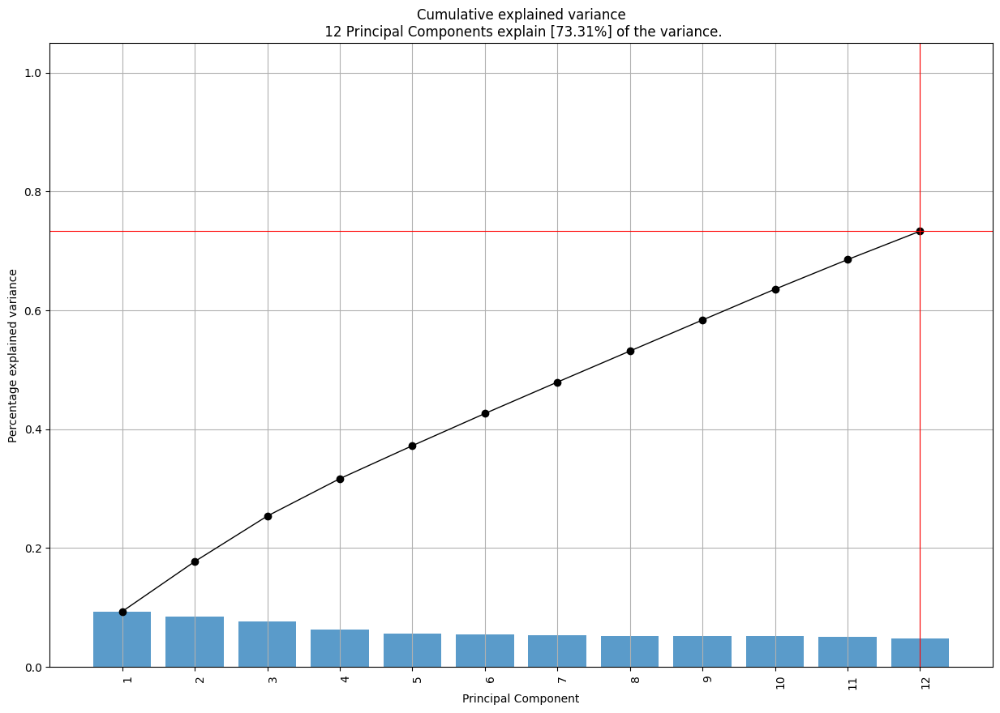

In [19]:
# libreria
from pca import pca

# Implementacion del modelo PCA 
model = pca(12, normalize=False, verbose=True, random_state=99)
results = model.fit_transform(df_info_clientes_banco_scaled)

# Gráfica
fig, ax = model.plot()

In [20]:
#ver los pesos o loadings
loadings_pca=model.results['loadings'].transpose()

# implementamos el pc en el set de variables predictoras
df_PCA = pd.DataFrame(df_info_clientes_banco_scaled.dot(loadings_pca))

# Implementar algoritmo de k medias sobre los datos estandarizados y la configuracion solicitada
kmeans_2 = KMeans(n_clusters = 3, random_state = 123, n_init=10).fit(df_PCA)

In [34]:
# agregar los cluster al df
df_info_clientes_banco['Cluster'] = kmeans_2.labels_
# describe sobre el df con los labels
df_info_clientes_banco.groupby('Cluster').describe()

CLIENTE                                                  \
               count         mean          std      min          25%   
Cluster                                                                
0        5662.000000 24325.717768 13737.006576 1.000000 11363.250000   
1       18200.000000 24546.049176 13914.236051 2.000000 12507.750000   
2       24009.000000 23381.646341 13744.206250 4.000000 11638.000000   

                                               Numero_de_transacciones  \
                 50%          75%          max                   count   
Cluster                                                                  
0       25234.000000 36593.500000 47869.000000             5662.000000   
1       24891.500000 36919.250000 47870.000000            18200.000000   
2       23082.000000 34934.000000 47871.000000            24009.000000   

                                                                             \
             mean       std      min      25%      50%       75%        max   
Cluster                                                                       
0       12.687390 18.433468 1.000000 2.000000 5.000000 15.000000 142.000000   
1        3.345549  3.972195 1.000000 1.000000 2.000000  4.000000  64.000000   
2        4.607064  5.938739 1.000000 1.000000 2.000000  5.000000  62.000000   

        promedio_por_transaccion                                           \
                           count          mean            std         min   
Cluster                                                                     
0                    5662.000000 935247.802919 1094834.763393    1.000000   
1                   18200.000000 329120.081486  462765.861565 1000.000000   
2                   24009.000000 270883.157724  372730.505392 1000.000000   

                                                                   \
                  25%           50%            75%            max   
Cluster                                                             
0       195008.202500 502088.950000 1236402.125000 6262025.000000   
1        77730.950000 163056.720000  360864.405000 4100000.000000   
2        74900.000000 144500.000000  293054.400000 3797796.000000   

        transaccion_minima                                                     \
                     count          mean            std      min          25%   
Cluster                                                                         
0              5662.000000 536325.877068 1016381.176960 1.000000 22000.000000   
1             18200.000000 244734.029515  437580.890858 0.040000 37000.000000   
2             24009.000000 192628.855905  352105.397762 1.000000 30000.000000   

                                                  transaccion_maxima  \
                 50%           75%            max              count   
Cluster                                                                
0       95448.860000 474872.580000 6148920.000000        5662.000000   
1       90600.000000 236869.250000 4100000.000000       18200.000000   
2       70066.000000 189000.000000 3797796.000000       24009.000000   

                                                                 \
                  mean            std         min           25%   
Cluster                                                           
0       1731480.555669 1685715.241138    1.000000 464003.250000   
1        455132.761603  599934.963221 1000.000000 100000.000000   
2        404563.100311  514768.440127 1000.000000 103570.000000   

                                                       \
                   50%            75%             max   
Cluster                                                 
0       1164988.000000 2482719.875000 11040000.000000   
1        229800.000000  525481.000000  6165920.000000   
2        220000.000000  480000.000000  6000000.000000   

        porcentaje_visa_nacional                                         \
                           count      mea

<Axes: xlabel='0', ylabel='1'>

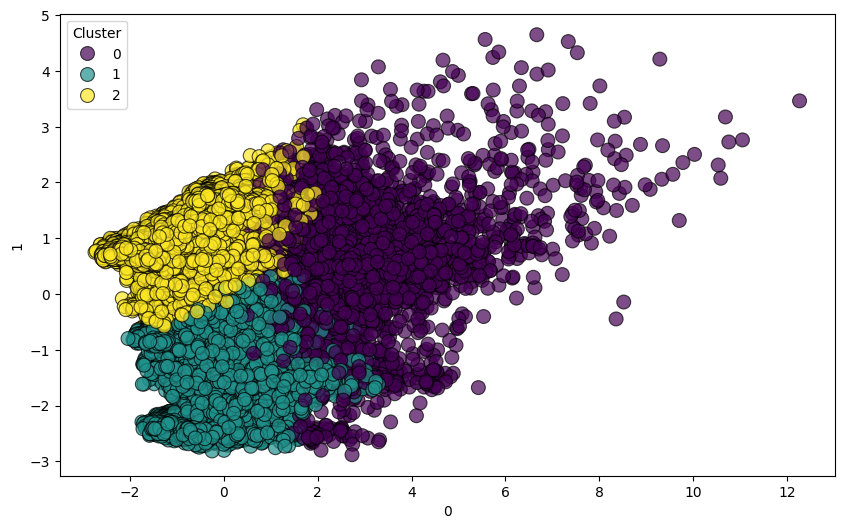

In [22]:
# Graficar
plt.figure(figsize=(10, 6))
sns.scatterplot(
    x=df_PCA[0],  # Primer componente principal (PC1)
    y=df_PCA[1],  # Segundo componente principal (PC2)
    hue=df_PCA['Cluster'],  # Colorear según el cluster
    palette='viridis',  # Colores para los clusters
    s=100,  # Tamaño de los puntos
    alpha=0.7,  # Transparencia
    edgecolor='k'  # Color del borde
)

In [23]:
# Validar metricas
print("varianza_intra_cluster: ", kmeans_2.inertia_)
print("silhouette: ", silhouette_score(df_PCA, kmeans_2.labels_))

varianza_intra_cluster:  640128.760434431
silhouette:  0.13159318727432595


### DBSCAN

In [24]:
# Matriz de la distancia de Gower
dist_gower = gower.gower_matrix(df_info_clientes_banco_scaled)
pd.DataFrame(dist_gower)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

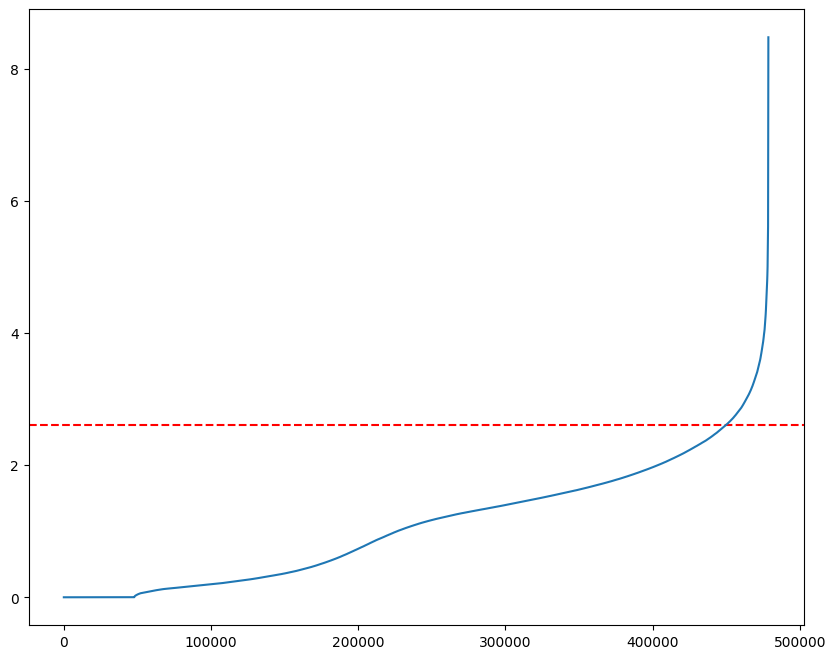

In [25]:
# Grafica de Neighbors para la seleccion de EPS
neigh = NearestNeighbors(n_neighbors = 10)
nbrs = neigh.fit(df_info_clientes_banco_scaled)
distancias, indices = nbrs.kneighbors(df_info_clientes_banco_scaled)
distancias = np.sort(distancias.flatten())

# grafica la curva
fig=plt.figure(figsize=(10,8), dpi= 100, facecolor='w', edgecolor='k')
# Line que muestra el codo de la curva
plt.axhline(y = 2.607528405499314, color = 'r', linestyle = '--')
plt.plot(distancias)

In [26]:
# Tomar el Eps de la grafica con la libreria Knee
i = np.arange(len(distancias))
knee = KneeLocator(i, distancias, S=14, curve='convex', direction='increasing', interp_method='interp1d')
knee_Eps = distancias[knee.knee]

print("El eps optimo es:", knee_Eps)

El eps optimo es: 2.347041890305896


In [27]:
# Aplicar el eps y el min_sample elegidos
db = DBSCAN(eps=knee_Eps, min_samples = df_info_clientes_banco_scaled.shape[1]*2 ) #Si hay más de dos dimensiones, Sander et al., (1998) sugieren utilizar al menos `min_samples= 2*dim`.
clusters=db.fit_predict(dist_gower)

In [28]:
# agregar los label al df
df_info_clientes_banco_X['Cluster'] = clusters
# describe sobre el df con los labels
df_info_clientes_banco_X.groupby('Cluster').describe()

CLIENTE                                                      \
               count         mean          std          min          25%   
Cluster                                                                    
-1      30114.000000 23753.567676 13852.443548     1.000000 11645.250000   
 0        280.000000 21214.028571 14034.730998     3.000000  9408.750000   
 1        783.000000 26374.417625 13400.042964     5.000000 15614.000000   
 2        346.000000 21831.395954 14239.220581    12.000000  9062.500000   
 3        401.000000 21912.516209 14024.607009    18.000000  9403.000000   
 4        694.000000 24438.051873 13650.281612    22.000000 13003.000000   
 5        290.000000 23945.689655 14373.063121    34.000000 11853.500000   
 6       1300.000000 24210.176923 13723.916530    43.000000 12913.750000   
 7        648.000000 24162.452160 14050.347427    45.000000 12519.000000   
 8        850.000000 22606.482353 13761.551171    50.000000 10838.750000   
 9        577.000000 22866.714038 13521.501121    52.000000 11596.000000   
 10      1143.000000 24997.484689 13628.351779    55.000000 13219.500000   
 11       320.000000 23105.690625 14342.695425    57.000000 10398.000000   
 12       670.000000 23650.468657 14063.314772    61.000000 11384.500000   
 13       273.000000 24572.084249 14020.797092    64.000000 11388.000000   
 14       845.000000 24050.026036 13485.745715    68.000000 13011.000000   
 15       838.000000 23998.566826 13700.646750    82.000000 12214.250000   
 16       337.000000 22388.385757 13412.326481    95.000000 11149.000000   
 17       849.000000 24322.848057 14102.254977   105.000000 12759.000000   
 18       780.000000 24244.775641 13868.013105   116.000000 12487.250000   
 19       400.000000 22350.970000 13717.395332   125.000000 10690.000000   
 20       643.000000 24879.651633 13795.946789   128.000000 13499.000000   
 21       404.000000 22609.725248 13474.178467   162.000000 11660.250000   
 22       878.000000 25186.903189 13430.882457   174.000000 13503.500000   
 23       340.000000 20715.350000 13211.386031   190.000000  9737.750000   
 24       417.000000 24256.338129 14047.962716   242.000000 12090.000000   
 25       657.000000 24467.312024 13564.834677   168.000000 13211.000000   
 26       309.000000 23157.122977 14176.559584   347.000000  9668.000000   
 27       263.000000 22856.076046 12415.133724   755.000000 13092.500000   
 28       189.000000 26527.597884 14477.151792   108.000000 14504.000000   
 29       142.000000 27370.295775 13141.741532   774.000000 16458.750000   
 30       143.000000 27292.006993 12664.380855   554.000000 17168.000000   
 31       139.000000 25681.302158 13225.623677    85.000000 15639.500000   
 32        97.000000 23958.917526 12667.295397  1981.000000 11954.000000   
 33        99.000000 28886.020202 12094.231049  5497.000000 18279.000000   
 34        46.000000 20634.434783  6431.124991  8131.000000 15940.000000   
 35        73.000000 31882.986301  9667.348721 13905.000000 24410.000000   
 36        66.000000 35754.287879  7938.827658 21162.000000 28705.500000   
 37        71.000000 35862.816901  7861.900745 20704.000000 29575.500000   
 38        70.000000 36406.957143  6951.030989 19806.000000 31494.750000   
 39        65.000000 36212.169231  7530.305907 19872.000000 30242.000000   
 40        22.000000 39210.954545  3555.611025 31532.000000 37691.500000   

                                               Numero_de_transacciones  \
                 50%          75%          max                   count   
Cluster                                                                  
-1      23700.500000 35892.750000 47869.000000            30114.000000   
 0      19502.500000 32737.750000 47822.000000              280.000000   
 1      27183.000000 38277.000000 47862.000000              783.000000   
 2      18508.500000 35276.750000 47623.000000              346.000000   
 3      19409.000000 34352.000000 47631.000000              401.000000   


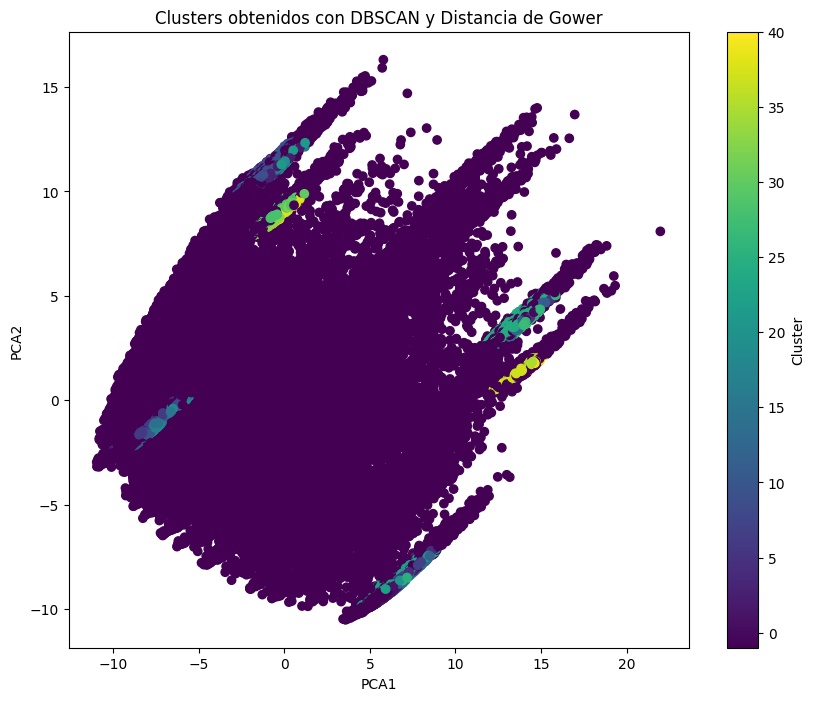

In [29]:
# Reducción de dimensionalidad con PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(dist_gower)

# Crear un DataFrame con las coordenadas PCA y los clusters
df_pca = pd.DataFrame(X_pca, columns=['PCA1', 'PCA2'])
df_pca['Cluster'] = clusters

# Graficar
plt.figure(figsize=(10, 8))
plt.scatter(df_pca['PCA1'], df_pca['PCA2'], c=df_pca['Cluster'], cmap='viridis', marker='o')
plt.colorbar(label='Cluster')
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.title('Clusters obtenidos con DBSCAN y Distancia de Gower')
plt.show()

In [30]:
# Validar metricas
print("silhouette: ", silhouette_score(df_info_clientes_banco_scaled, db.labels_))

silhouette:  0.01165340422035105
